# this is a merged version be become a script so as to get the most recent predictions from pickles

## TODO
### > ~~get last saved data to set download start date~~
### > ~~remove all plots and plot librarys~~
### > now call pickle on newly saved data...
### > pull a version of this that runs on pandas data-reader...
### > download documentation for URLIB library 

In [1]:
import pandas as pd
import os

## this pulls the most recent date from data

In [2]:
'''
os.listdir('data/')
lastdf = pd.read_csv('data/EVSI.csv')
lastdf = lastdf.set_index('date')
lastdf.index = pd.to_datetime(lastdf.index)
last_date = str(lastdf.index[-1]).split()[0]
last_date
'''

"\nos.listdir('data/')\nlastdf = pd.read_csv('data/EVSI.csv')\nlastdf = lastdf.set_index('date')\nlastdf.index = pd.to_datetime(lastdf.index)\nlast_date = str(lastdf.index[-1]).split()[0]\nlast_date\n"

## download data from that date

# Merge Down Step One and Insert it Here

## this is merged and it works

In [3]:


api = '26815f601e2c459e55a4510a897ea5dd'
try:
    # For Python 3.0 and later
    from urllib.request import urlopen
except ImportError:
    # Fall back to Python 2's urllib2
    from urllib2 import urlopen

import json

def get_jsonparsed_data(url):
    """
    Receive the content of ``url``, parse it as JSON and return the object.

    Parameters
    ----------
    url : str

    Returns
    -------
    dict
    """
    response = urlopen(url)
    data = response.read().decode("utf-8")
    return json.loads(data)


#+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
def save_dat_data(dtype,ticker,df):
    sheet_name = (ticker+'_'+dtype.replace('/','_'))
    p = 'fundamentals_data/'
    if not os.path.exists(p):
        os.mkdir(p)
    df.to_csv(p+sheet_name+'.csv')
    
def get_some(dtype,ticker):
    url = ("https://financialmodelingprep.com/api/v3/{}/{}?apikey=26815f601e2c459e55a4510a897ea5dd").format(dtype,ticker)
    data = get_jsonparsed_data(url)
    df = pd.DataFrame(data)
    save_dat_data(dtype,ticker,df)
    return df 
#dtype = 'income-statement-growth'
#ticker = 'AAPL'
def get_quarter(dtype,ticker):
    url = ("https://financialmodelingprep.com/api/v3/{}/{}?period=quarter&apikey=26815f601e2c459e55a4510a897ea5dd").format(dtype,ticker)
    data = get_jsonparsed_data(url) #.......................^ thats all you change
    df = pd.DataFrame(data)
    save_dat_data(dtype,ticker,df)
    return df 

def get_news():
    url = ("https://financialmodelingprep.com/api/v3/stock-news?tickers=AAPL,FB,GOOG,AMZN&apikey=26815f601e2c459e55a4510a897ea5dd")#.format(ticker_list)
    data = get_jsonparsed_data(url) #.......................^ thats all you change
    df = pd.DataFrame(data)
    save_dat_data(dtype,ticker,df)
    return df 

def get_price(ticker):
    pdf = get_some('historical-price-full',ticker)
    price_dic = pdf.historical
    pcdf = pd.DataFrame(dict(price_dic)).T.set_index('date')
    dtype = 'historical-price-full'
    save_dat_data(dtype,ticker,pcdf)
    return pcdf

ticker = 'PW'
df = get_price(ticker)
df.head()

df.tail()

# lets lose non-usefull data

df = df.drop('label',axis=1)
df = df[::-1]

## create features

### riz-variations

buys = []
sells = []
def make_riz_targets(df,buy_thresh = 11,sell_thresh = 89):
    buythresh = 'below_buy_thresh:'+str(buy_thresh)
    sellthresh = 'above_sell_thresh:'+str(sell_thresh)
    df[buythresh] = df.riz < buy_thresh
    df[sellthresh] = df.riz > sell_thresh
    buy_corner = 'buy_corner:'+str(buy_thresh)
    sell_corner = 'sell_corner:'+str(sell_thresh)
    df[buy_corner] = (df[buythresh].shift() == True) & (df.riz > df.riz.shift())
    df[sell_corner] = (df[sellthresh].shift() == True) & (df.riz < df.riz.shift())
    buys.append(buy_corner)
    sells.append(sell_corner)
    #add touch eventually
    buy_touch = 'buy_touch:'+str(buy_thresh)
    sell_touch = 'sell_touch:'+str(sell_thresh)
    df[buy_touch] = (df[buythresh].shift()==False) & (df[buythresh]==True)
    df[sell_touch] = (df[sellthresh].shift()==False) & (df[sellthresh]==True)
    buys.append(buy_touch)
    sells.append(sell_touch)
    return df


df = df.rename(columns={'open':'Open','close':'Close','high':'High','low':'Low'})

import pandas_ta as pta

df['riz'] = pta.momentum.rsi(df.Close,length=2)
df.head()

#default val
df = make_riz_targets(df)
df = make_riz_targets(df,30,70)
df = make_riz_targets(df,20,80)
df = make_riz_targets(df,15,85)
df = make_riz_targets(df,40,60)
df.head()

## i can make my own vwap riz... sweet

import ta

ddf = df.copy

df['vwap_riz'] = pta.momentum.rsi(df['vwap'])
df['vwap_riz_ema']= pta.ema(df['vwap_riz'])
df['vwap_ab_avg'] = df['vwap_riz']>df['vwap_riz_ema']
df['vwap_bl_avg'] = df['vwap_riz']<df['vwap_riz_ema']

df

## im only going to do 2 different sto's b/c they kill so much of the df

df

df = df.join(pta.momentum.stoch(df.High,df.Low,df.Close))




multi = 2
df = df.join(pta.momentum.stoch(df.High,
                                      df.Low,
                                      df.Close,
                                      fast_k=14*multi,
                                     slow_k=5*multi,
                                     slow_d=3*multi))
multi = 3
df = df.join(pta.momentum.stoch(df.High,
                                      df.Low,
                                      df.Close,
                                      fast_k=14*multi,
                                     slow_k=5*multi,
                                     slow_d=3*multi))

len(df.columns)

df['trip_sto_bl30'] = df['STOCHFk_42']<30
df['trip_sto_ab50'] = df['STOCHFk_42']>50
df['doub_sto_ab50'] = df['STOCHFk_28']>50
df['sto_below30']   = df['STOCHFk_14']<30
df['trp_sto_ab_50n_short_below'] = (df['trip_sto_ab50']==True) & (df['sto_below30']==True)
#++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


### sto_dif

def hl(df):
    def highlight(boo):
        criteria = (boo==True)
        return['background-color: green' if i else '' for i in criteria]
    df = df.style.apply(highlight)
    return df

hl(df)

## add targets

#first ill seperate the features
features = df.copy()

## saving the dirty raw check point

path = 'data/'
df.to_csv(path+ticker+'.csv')
os.listdir()





#import seaborn as #sns
#sns.heatmap(df.isnull())
#df = df.dropna(axis=0).isnull()
#sns.heatmap(df.isnull())

len(df)

ticker



## and other pta shit
#### this may merge or become a seperate project but i want to know the coeficiants on the pta indicators - what do good models like? what are the favs
#### compare across securities
#### another project is to provide nothing but bools to the model and see if it can make use of it...to hard code models



### ok im dumb i didnt have to make a mask i could just transpose it and limit cols same way i match like this df.T = df.T[other_df.T.columns]

from datetime import datetime
clean_initiate= datetime.now()

info = {}
from datetime import datetime
import math
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#import seaborn as #sns
import cufflinks as cf
pd.set_option('display.max_columns',1000)
pd.set_option('display.max_rows',10000)
cf.go_offline(connected=False)
stamp = str(datetime.now())
info['stamp'] = stamp
import os
path = 'data/'
info['path'] = path
sheets = os.listdir(path)
pd.DataFrame(sheets)

            
'''TARGETS!'''            
#STD TARGETS            
def std_targs(df=df,t1=0.5,t2=1,t3=2,roll_len=10,hi_rol_lo=10):
    #this reruns a data frame and targets with tuple unpacking...,
    #anything that could leak information has a:! in it...
    #roll_len = is the period of standard deviation
    #hi_rol_lo = is the rolling period of which to pull futur Highs and Lows
    df['STD'] = df['Close'].rolling(roll_len).std()
    #name the up targets
    ut1 = ('STDR'+str(hi_rol_lo)+':up_target:_'+str(t1)+'!')
    ut2 = ('STDR'+str(hi_rol_lo)+':up_target:_'+str(t2)+'!')
    ut3 = ('STDR'+str(hi_rol_lo)+':up_target:_'+str(t3)+'!')
    #name the down targets
    dt1 = ('STDR'+str(hi_rol_lo)+':down_target:_'+str(t1)+'!')
    dt2 = ('STDR'+str(hi_rol_lo)+':down_target:_'+str(t2)+'!')
    dt3 = ('STDR'+str(hi_rol_lo)+':down_target:_'+str(t3)+'!')
    #create the std values
    st1 = df['STD'] * t1
    st2 = df['STD'] * t2
    st3 = df['STD'] * t3
    
    #create the targets/stops
    df[ut1] = (df['High'] +  st1)
    df[dt1] = (df['Low'] -  st1)
    df[ut2] = (df['High'] +  st2)
    df[dt2] = (df['Low'] -  st2)
    df[ut3] = (df['High'] + st3)
    df[dt3] = (df['Low'] -  st3)

    #now create a count for each one with an upside down dataframe!!! yeet!
    df = df[::-1]
    rollingh = ('High_ahead!')#,str(hi_rol_lo)+'!')
    rollingl = ('Low_ahead!')#,str(hi_rol_lo)+'!')
    df[rollingh] = df.High.rolling(hi_rol_lo).max()
    df[rollingl] = df.Low.rolling(hi_rol_lo).min()
    df = df[::-1]
    #now we run bools on weather they are in range
    
    #name the new columns
    uth1 = ut1.replace('!','_HIT!')
    uth2 = ut2.replace('!','_HIT!')
    uth3 = ut3.replace('!','_HIT!')
    dth1 = dt1.replace('!','_HIT!')
    dth2 = dt2.replace('!','_HIT!')
    dth3 = dt3.replace('!','_HIT!')
    #make booleans of the action!
    df[dth3] = df[rollingl] < df[dt3]
    df[dth2] = df[rollingl] < df[dt2]
    df[dth1] = df[rollingl] < df[dt1]
    #i put Close in the middle for visual efffect evaluating the frame!
    #df['cClosee'] = df['Close']
    df[uth1] = df[rollingh] > df[ut1]
    df[uth2] = df[rollingh] > df[ut2]
    df[uth3] = df[rollingh] > df[ut3]
    
    #ts = [ut1,ut2,ut3,dt1,dt2,dt3]
    ts = ['Close',dt3,dt2,dt1,ut1,ut2,ut3]
    #ths = [uth1,uth2,uth3,dth1,dth2,dth3]
    ths = ['Close',dth3,dth2,dth1,uth1,uth2,uth3]
    print('these ARE targets!:\n',ts)
    return df,ths,ts

def add_targets(df):
    #df = df[['High','Low']]
    df['plus_10!'] = df['High'] + (df['High']* .1)
    df['minus_10!'] = df['Low'] - (df['Low']* .1)
    df['plus_20!'] = df['High'] + (df['High']* .2)
    df['minus_20!'] = df['Low'] - (df['Low']* .2)
    df['minus_5!'] = df['Low'] - (df['Low']* .05)
    df['plus_5!'] = df['High'] + (df['High']* .05)
    df['minus_5!'] = df['Low'] - (df['Low']* .05)
    df
    
    df = df[::-1]
    df['Highlast_10!'] = df['High'].rolling(10).max()
    df['Lowlast_10!'] = df['Low'].rolling(10).min()
    df  = df[::-1]

    df['uped_10!'] = df['plus_10!'] <= df['Highlast_10!']
    df['downed_10!'] = df['minus_10!'] >= df['Lowlast_10!']
    df['uped_20!'] = df['plus_20!'] <= df['Highlast_10!']
    df['downed_20!'] = df['minus_20!'] >= df['Lowlast_10!']
    df['uped_5!'] = df['plus_5!'] <= df['Highlast_10!']
    df['downed_5!'] = df['minus_5!'] >= df['Lowlast_10!']
    return(df)

## scale and plot functions
from sklearn.preprocessing import StandardScaler    
def scale(df):
    '''returns your data frame scaled!'''
    scale = StandardScaler()
    scaled = scale.fit_transform(df)
    sdf = pd.DataFrame(scaled,columns=df.columns)
    return sdf

'''
def sola(df,title=None):
    return df.iplot(theme='#solar',fill=True,title=title)
'''


#sns.heatmap(df.isnull())

#sns.heatmap(df.isnull())

#### SAVE TO CSV

df = df.reset_index()#.drop('index',axis=1)


df.head()




df.head()


feature_frame = df.copy()

# TARGETS

stdf = std_targs(df,t1=2,t2=3,t3=4)
df = df.merge(stdf[0])
targs = []
for i in df.columns:
    if '!' in i:
        targs.append(i)


#sola(df[stdf[2]])


ts = stdf[1]
targetframe = df[ts]
targetframe.replace(True,targetframe['Close'])

i = ts[2]
for i in targetframe.columns:
    targetframe[i] = targetframe[i].replace(True,targetframe['Close'])
    targetframe[i] = targetframe[i].replace(1,targetframe['Close'])

ups = []
downs=[]
for i in targetframe.columns:
    if 'up' in i:
        ups.append(i)
    if 'down' in i:
        downs.append(i)

#sola(targetframe)

pd.DataFrame(ts)

up = ts[2]
down = ts[-2]
#sola(targetframe[['Close',up,down]])

downs.append('Close')

ups.append('Close')

#sola(targetframe[ups])

#sola(targetframe[downs])

## i think i need some more rare targets...

stdf[0]

#sns.heatmap(df.isnull())

pd.DataFrame(targs)

## longer term targets

## IDEAS
### >5ma > 10ma
### >price > 5ma
### > price > 10ma


df['Close']

df



df = add_targets(df)

uped = []
downed = []
for i in df.columns:
    if 'uped' in i:
        uped.append(i)
    if 'downed' in i:
        downed.append(i)
print(uped)
print(downed)



df





scales = []
for i in df.columns:
    if 'uped' in i:
        df['scale_'+i] = df[i].replace(True,1).replace(1,df['Close'])
        scales.append('scale_'+i)
    if 'downed' in i:
        df['scale_'+i] = df[i].replace(True,1).replace(1,df['Close'])
        scales.append('scale_'+i)

pd.DataFrame(scales)

scales

scales.append('Close')


#sola(df[[scales[0],'Close',scales[3]]])

#sola(df[[scales[5],'Close',scales[4]]])

# long term targets

df

df['ma5'] = df['Close'].rolling(5).mean()
df['ma10']= df['Close'].rolling(10).mean()
df['ma20'] = df['Close'].rolling(5).mean()
df['ma40']= df['Close'].rolling(10).mean()
#sola(df[['ma5','ma10','Close']])

df['ma5_above_ma10'] = df['ma5'] > df['ma10']
df['ma5_below_ma10'] = df['ma5'] < df['ma10']
df['scale_ma5_above'] = df['ma5_above_ma10'].replace(True,1).replace(1,df.Close)
df['scale_ma5_below'] = df['ma5_below_ma10'].replace(True,1).replace(1,df.Close)
#+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++

#sola(df[['scale_ma5_below','Close','scale_ma5_above']])

df['ma5_above_ma10_in5!']  = df['ma5_above_ma10'].shift(-5)   
df['ma5_below_ma10_in5!']  = df['ma5_below_ma10'].shift(-5) 
df['scale_ma5_above_in5!'] = df['scale_ma5_above'].shift(-5)
df['scale_ma5_below_in5!'] = df['scale_ma5_below'].shift(-5)

#sola(df[['ma5_above_ma10_in5!','ma5_below_ma10_in5!']])

#df['scale_ma5_above_in5!'] = df['ma5_above_ma10_in5!'].replace(True,1).replace(1,df.Close)
#df['scale_ma5_below_in5!'] = df['ma5_below_ma10_in5!'].replace(True,1).replace(1,df.Close)

#sola(df[['scale_ma5_below_in5!','Close','scale_ma5_above_in5!']])

df = df.dropna(axis=0)
#sns.heatmap(df.isnull())



start = df.index[0]
last =  df.index[-1]
print('starts:',start,'ends:',last)

mask = (feature_frame.index >= start) & (feature_frame.index <= last)
fedf = feature_frame[mask]

print('feature_frame is:',len(fedf))
print('target_frame is:',len(df))

df.head()

fedf.head()

# save em!

sdf = scale(fedf.drop('date',axis=1))
sdf['date'] = df['date']

sdf
#sola(sdf)

#og = sheet.split('/')[1]
og = ticker

path = 'clean_data/'
if not os.path.exists(path):
    os.mkdir(path)

sdf.to_csv(path+'scaled_features_'+og)
fedf.to_csv(path+'features_'+og)
df.to_csv(path+'targets_'+og)
scaled_feature_frame = sdf.copy()

clean_compleate = datetime.now()
notebook_runtime = clean_compleate - clean_initiate
print('notebook ran in: ',notebook_runtime)

df



these ARE targets!:
 ['Close', 'STDR10:down_target:_4!', 'STDR10:down_target:_3!', 'STDR10:down_target:_2!', 'STDR10:up_target:_2!', 'STDR10:up_target:_3!', 'STDR10:up_target:_4!']
['uped_10!', 'uped_20!', 'uped_5!']
['downed_10!', 'downed_20!', 'downed_5!']
starts: 36 ends: 1143
feature_frame is: 1108
target_frame is: 1108
notebook ran in:  0:00:19.591903


,date,Open,High,Low,Close,adjClose,volume,unadjustedVolume,change,changePercent,vwap,changeOverTime,riz,below_buy_thresh:11,above_sell_thresh:89,buy_corner:11,sell_corner:89,buy_touch:11,sell_touch:89,below_buy_thresh:30,above_sell_thresh:70,buy_corner:30,sell_corner:70,buy_touch:30,sell_touch:70,below_buy_thresh:20,above_sell_thresh:80,buy_corner:20,sell_corner:80,buy_touch:20,sell_touch:80,below_buy_thresh:15,above_sell_thresh:85,buy_corner:15,sell_corner:85,buy_touch:15,sell_touch:85,below_buy_thresh:40,above_sell_thresh:60,buy_corner:40,sell_corner:60,buy_touch:40,sell_touch:60,vwap_riz,vwap_riz_ema,vwap_ab_avg,vwap_bl_avg,STOCHFk_14,STOCHFd_3,STOCHk_5,STOCHd_3,STOCHFk_28,STOCHFd_6,STOCHk_10,STOCHd_6,STOCHFk_42,STOCHFd_9,STOCHk_15,STOCHd_9,trip_sto_bl30,trip_sto_ab50,doub_sto_ab50,sto_below30,trp_sto_ab_50n_short_below,STD,STDR10:up_target:_2!,STDR10:down_target:_2!,STDR10:up_target:_3!,STDR10:down_target:_3!,STDR10:up_target:_4!,STDR10:down_target:_4!,High_ahead!,Low_ahead!,STDR10:down_target:_4_HIT!,STDR10:down_target:_3_HIT!,STDR10:down_target:_2_HIT!,STDR10:up_target:_2_HIT!,STDR10:up_target:_3_HIT!,STDR10:up_target:_4_HIT!,plus_10!,minus_10!,plus_20!,minus_20!,minus_5!,plus_5!,Highlast_10!,Lowlast_10!,uped_10!,downed_10!,uped_20!,downed_20!,uped_5!,downed_5!,scale_uped_10!,scale_downed_10!,scale_uped_20!,scale_downed_20!,scale_uped_5!,scale_downed_5!,ma5,ma10,ma20,ma40,ma5_above_ma10,ma5_below_ma10,scale_ma5_above,scale_ma5_below,ma5_above_ma10_in5!,ma5_below_ma10_in5!,scale_ma5_above_in5!,scale_ma5_below_in5!
36,2015-12-04,4.3,4.31,4.24,4.3,4.3,3000,3000,0,0,4.28333,0,96.674005,False,True,False,True,False,False,False,True,False,True,False,False,False,True,False,True,False,False,False,True,False,True,False,False,False,True,False,True,False,False,54.793945,47.733068,True,False,96.875,9.895833e+01,95.167208,85.280844,97.8723,82.551373,68.628125,50.022261,97.8723,54.718630,39.829049,26.694394,False,True,True,False,False,0.116886,4.54377,4.00623,4.66066,3.88934,4.77754,3.77246,4.320000,3.900000,False,False,True,False,False,False,4.741,3.816,5.172,3.392,4.028,4.5255,4.320000,3.900000,False,False,False,False,False,True,0.000000,0.000000,0.00,0.000000,0.000000,4.300000,4.234000,4.142,4.234000,4.142,True,False,4.300000,0.000000,False,True,0.000000,4.190000
37,2015-12-07,4.21,4.23,4.07,4.14,4.14,2400,2400,-0.07,-1.663,4.14667,-0.01663,13.658350,False,False,False,True,False,False,True,False,False,True,True,False,True,False,False,True,True,False,True,False,False,True,True,False,True,False,False,True,True,False,47.499410,47.690584,False,True,46.875,8.125000e+01,88.178571,89.611652,63.8298,86.352064,72.911103,56.908000,63.8298,59.144162,43.784743,28.401131,False,True,True,False,False,0.113333,4.45667,3.84333,4.57,3.73,4.68333,3.61667,4.320000,3.900000,False,False,False,False,False,False,4.653,3.663,5.076,3.256,3.8665,4.4415,4.320000,3.900000,False,False,False,False,False,False,0.000000,0.000000,0.00,0.000000,0.000000,0.000000,4.240000,4.150,4.240000,4.150,True,False,4.140000,0.000000,False,True,0.000000,4.150000
38,2015-12-08,4.13,4.24,4.12,4.24,4.24,2300,2300,0.11,2.663,4.2,0.02663,58.357392,False,False,False,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,50.281055,48.161579,True,False,70.8333,7.152778e+01,82.916667,88.754149,85.1064,88.998000,75.105952,63.080607,85.1064,65.822649,48.616396,30.976654,False,True,True,False,False,0.114431,4.46886,3.89114,4.58329,3.77671,4.69772,3.66228,4.320000,3.900000,False,False,False,False,False,False,4.664,3.708,5.088,3.296,3.914,4.452,4.320000,3.900000,False,False,False,False,False,True,0.000000,0.000000,0.00,0.000000,0.000000,4.240000,4.252000,4.165,4.252000,4.165,True,False,4.240000,0.000000,False,True,0.000000,4.270000
39,2015-12-09,4.17,4.18,4.13,4.18,4.18,1700,1700,0.01,0.24,4.16333,0.0024,35.995539,False,False,False,False,False,False,False,False,False,False,False,False,False,Fa

In [4]:
os.system('printf\a')

32512

## functions

In [5]:
import pickle
def load_pickle(model_name):
    # load the model from disk
    pickle_path = ('pickles/')
    filename    = pickle_path+model_name
    loaded_model = pickle.load(open(filename, 'rb'))
    
    #result = loaded_model.score(x_test, y_test)
    return loaded_model


scale_li = []
def scale_true_to_price(df,model_name):
    sname = model_name+'_scaled'
    df[sname] = df[model_name].replace(True,1).replace(False,0).replace(1,df.Close)
    scale_li.append(sname)


import cufflinks as cf
cf.go_offline(connected=False)
def sola(df,title=None):
    return df.iplot(theme='solar',fill=True,title=title)

## scale and plot functions
from sklearn.preprocessing import StandardScaler    
def scale(df):
    '''returns your data frame scaled!'''
    scale = StandardScaler()
    scaled = scale.fit_transform(df)
    sdf = pd.DataFrame(scaled,columns=df.columns)
    sdf.index = df.index
    return sdf

def hl(df):
    def highlight(boo):
        criteria = boo == True
        return['background-color: green'if i else '' for i in criteria]
    df = df.style.apply(highlight)
    return df

### Everything here is just basically an add on to the first script

# Pull Prefered Models and Return Current Pred

In [6]:
import pandas as pd
import numpy as np

## load the new data

In [7]:
# the problem with using this is it has been cleaned up so the most recent dates will not show
#df = pd.read_csv('clean_data/scaled_features_PW')

In [8]:
df = pd.read_csv('data/PW.csv')
df['date'] = pd.to_datetime(df['date'])

In [9]:
len(df.columns)

64

In [10]:
targs = [i for i in df.columns if '!' in i]
targs

[]

## recall the pickle

In [11]:
m = 'forest861561'#models[1]
pickle =load_pickle(m)

In [12]:
import seaborn as sns


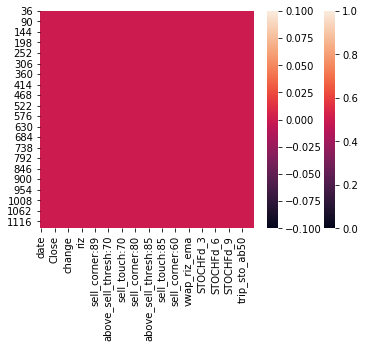

In [13]:
sns.heatmap(df.isnull())
df = df.dropna(axis=0)
sns.heatmap(df.isnull())

## if the model recieves scaled data, scale its inputs

In [14]:
sdf = scale(df.drop('date',axis=1))

In [15]:
sdf['date'] = df['date']

In [16]:
set(df.columns)-set(sdf.columns)

set()

## some how i am uploading data with targets
### i'm going to try uploading data from clean data dir


In [17]:
len(df.columns)

64

In [18]:
df.head(1)

,date,Open,High,Low,Close,adjClose,volume,unadjustedVolume,change,changePercent,vwap,changeOverTime,riz,below_buy_thresh:11,above_sell_thresh:89,buy_corner:11,sell_corner:89,buy_touch:11,sell_touch:89,below_buy_thresh:30,above_sell_thresh:70,buy_corner:30,sell_corner:70,buy_touch:30,sell_touch:70,below_buy_thresh:20,above_sell_thresh:80,buy_corner:20,sell_corner:80,buy_touch:20,sell_touch:80,below_buy_thresh:15,above_sell_thresh:85,buy_corner:15,sell_corner:85,buy_touch:15,sell_touch:85,below_buy_thresh:40,above_sell_thresh:60,buy_corner:40,sell_corner:60,buy_touch:40,sell_touch:60,vwap_riz,vwap_riz_ema,vwap_ab_avg,vwap_bl_avg,STOCHFk_14,STOCHFd_3,STOCHk_5,STOCHd_3,STOCHFk_28,STOCHFd_6,STOCHk_10,STOCHd_6,STOCHFk_42,STOCHFd_9,STOCHk_15,STOCHd_9,trip_sto_bl30,trip_sto_ab50,doub_sto_ab50,sto_below30,trp_sto_ab_50n_short_below
36,2015-12-04,4.3,4.31,4.24,4.3,4.3,3000.0,3000.0,0.0,0.0,4.28333,0.0,96.674005,False,True,False,True,False,False,False,True,False,True,False,False,False,True,False,True,False,False,False,True,False,True,False,False,False,True,False,True,False,False,54.793945,47.733068,True,False,96.875,98.958333,95.167208,85.280844,97.87234,82.551373,68.628125,50.022261,97.87234,54.71863,39.829049,26.694394,False,True,True,False,False


## determain the column order by the coeficiants that went into it...
### ~~somehow the order of the columns is incorrect...~~

In [19]:
#codf = pd.read_csv('PREDICTION_DATA/coefs_STDR10:down_target:_2_HIT!_split:750.csv')..........................

codf = pd.read_csv('PREDICTION_DATA/coefs_STDR10:down_target:_2_HIT!_split:750.csv').set_index('features')
codf = codf.T
codf.head()

features,Open,High,Low,Close,adjClose,volume,unadjustedVolume,change,changePercent,vwap,changeOverTime,riz,below_buy_thresh:11,above_sell_thresh:89,buy_corner:11,sell_corner:89,buy_touch:11,sell_touch:89,below_buy_thresh:30,above_sell_thresh:70,buy_corner:30,sell_corner:70,buy_touch:30,sell_touch:70,below_buy_thresh:20,above_sell_thresh:80,buy_corner:20,sell_corner:80,buy_touch:20,sell_touch:80,below_buy_thresh:15,above_sell_thresh:85,buy_corner:15,sell_corner:85,buy_touch:15,sell_touch:85,below_buy_thresh:40,above_sell_thresh:60,buy_corner:40,sell_corner:60,buy_touch:40,sell_touch:60,vwap_riz,vwap_riz_ema,vwap_ab_avg,vwap_bl_avg,STOCHFk_14,STOCHFd_3,STOCHk_5,STOCHd_3,STOCHFk_28,STOCHFd_6,STOCHk_10,STOCHd_6,STOCHFk_42,STOCHFd_9,STOCHk_15,STOCHd_9,trip_sto_bl30,trip_sto_ab50,doub_sto_ab50,sto_below30,trp_sto_ab_50n_short_below
Unnamed: 0,0.00000,1.00000,2.000000,3.000000,4.000000,5.000000,6.000000,7.000000,8.000000,9.000000,10.000000,11.000000,12.000000,13.000000,14.000000,15.000000,16.000000,17.000000,18.000000,19.000000,20.00000,21.000000,22.000000,23.000000,24.000000,25.000000,26.000000,27.000000,28.000000,29.000000,30.000000,31.000000,32.000000,33.000000,34.00000,35.000000,36.000000,37.000000,38.00000,39.00000,40.000000,41.000000,42.000000,43.000000,44.000000,45.000000,46.000000,47.000000,48.000000,49.000000,50.000000,51.00000,52.000000,53.000000,54.000000,55.000000,56.00000,57.00000,58.000000,59.000000,60.000000,61.000000,62.000000
coef,0.24635,0.00864,0.741744,0.268435,0.268435,1.566166,1.566166,0.240278,0.434114,0.326843,0.434114,0.288249,0.348695,0.203479,0.340552,0.017511,0.022828,0.208131,0.307822,0.137266,0.03279,0.260676,0.011313,0.075374,1.013209,0.050139,0.546192,0.386492,0.256965,0.137381,0.025886,0.354912,0.055313,0.442398,0.00194,0.135628,0.201848,0.085662,0.12735,0.31513,0.113537,0.047667,0.356156,0.188095,0.003095,0.003095,0.488241,0.106186,0.285678,0.397788,0.908159,0.58292,0.024843,0.453443,0.066877,0.728591,0.23431,0.08403,0.569326,0.237272,0.902527,0.233771,0.152703
true_coef,0.24635,0.00864,0.741744,0.268435,0.268435,-1.566166,-1.566166,0.240278,-0.434114,0.326843,-0.434114,-0.288249,0.348695,-0.203479,0.340552,-0.017511,0.022828,-0.208131,0.307822,0.137266,-0.03279,0.260676,-0.011313,0.075374,-1.013209,-0.050139,-0.546192,0.386492,0.256965,0.137381,0.025886,0.354912,-0.055313,-0.442398,0.00194,-0.135628,-0.201848,-0.085662,0.12735,-0.31513,0.113537,0.047667,-0.356156,0.188095,-0.003095,0.003095,0.488241,-0.106186,0.285678,0.397788,0.908159,-0.58292,0.024843,0.453443,-0.066877,-0.728591,0.23431,0.08403,-0.569326,0.237272,-0.902527,0.233771,-0.152703


In [20]:
len(codf.columns)

63

In [21]:
len(df[codf.columns].columns)


63

In [22]:
df

,date,Open,High,Low,Close,adjClose,volume,unadjustedVolume,change,changePercent,vwap,changeOverTime,riz,below_buy_thresh:11,above_sell_thresh:89,buy_corner:11,sell_corner:89,buy_touch:11,sell_touch:89,below_buy_thresh:30,above_sell_thresh:70,buy_corner:30,sell_corner:70,buy_touch:30,sell_touch:70,below_buy_thresh:20,above_sell_thresh:80,buy_corner:20,sell_corner:80,buy_touch:20,sell_touch:80,below_buy_thresh:15,above_sell_thresh:85,buy_corner:15,sell_corner:85,buy_touch:15,sell_touch:85,below_buy_thresh:40,above_sell_thresh:60,buy_corner:40,sell_corner:60,buy_touch:40,sell_touch:60,vwap_riz,vwap_riz_ema,vwap_ab_avg,vwap_bl_avg,STOCHFk_14,STOCHFd_3,STOCHk_5,STOCHd_3,STOCHFk_28,STOCHFd_6,STOCHk_10,STOCHd_6,STOCHFk_42,STOCHFd_9,STOCHk_15,STOCHd_9,trip_sto_bl30,trip_sto_ab50,doub_sto_ab50,sto_below30,trp_sto_ab_50n_short_below
36,2015-12-04,4.300000,4.310000,4.240000,4.300000,4.300000,3000.0,3000.0,0.00,0.000,4.28333,0.00000,96.674005,False,True,False,True,False,False,False,True,False,True,False,False,False,True,False,True,False,False,False,True,False,True,False,False,False,True,False,True,False,False,54.793945,47.733068,True,False,96.875000,9.895833e+01,95.167208,85.280844,97.872340,82.551373,68.628125,50.022261,97.872340,54.718630,39.829049,26.694394,False,True,True,False,False
37,2015-12-07,4.210000,4.230000,4.070000,4.140000,4.140000,2400.0,2400.0,-0.07,-1.663,4.14667,-0.01663,13.658350,False,False,False,True,False,False,True,False,False,True,True,False,True,False,False,True,True,False,True,False,False,True,True,False,True,False,False,True,True,False,47.499410,47.690584,False,True,46.875000,8.125000e+01,88.178571,89.611652,63.829787,86.352064,72.911103,56.908000,63.829787,59.144162,43.784743,28.401131,False,True,True,False,False
38,2015-12-08,4.130000,4.240000,4.120000,4.240000,4.240000,2300.0,2300.0,0.11,2.663,4.20000,0.02663,58.357392,False,False,False,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,50.281055,48.161579,True,False,70.833333,7.152778e+01,82.916667,88.754149,85.106383,88.998000,75.105952,63.080607,85.106383,65.822649,48.616396,30.976654,False,True,True,False,False
39,2015-12-09,4.170000,4.180000,4.130000,4.180000,4.180000,1700.0,1700.0,0.01,0.240,4.16333,0.00240,35.995539,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True,False,48.382809,48.201803,True,False,45.833333,5.451389e+01,72.083333,81.059524,72.340426,86.524823,75.761047,68.119931,72.340426,72.100298,52.737337,34.214168,False,True,True,False,False
40,2015-12-11,3.900000,4.200000,3.900000,4.200000,4.200000,6200.0,6200.0,0.30,7.692,4.10000,0.07692,49.019062,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,45.208483,47.657563,False,True,73.170732,6.327913e+01,66.717480,73.905827,74.418605,82.261257,79.100344,72.224577,76.595745,78.850760,56.089334,38.003077,False,True,True,False,False
41,2015-12-14,4.110000,4.200000,4.100000,4.190000,4.190000,2600.0,2600.0,0.08,1.946,4.16333,0.01946,40.731153,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,48.824319,47.869700,True,False,85.294118,6.809939e+01,64.401303,67.734039,70.731707,77.383208,82.070950,75.596254,74.468085,84.154695,59.053873,42.664100,False,True,True,False,False
42,2015-12-15,4.190000,4.300000,4.150000,4.150000,4.150000,3100.0,3100.0,-0.04,-0.955,4.20000,-0.00955,17.313238,False,False,False,False,False,False,True,False,False,False,True,False,True,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,True,False,50.847018,48.411031,True,False,62.500000,7.365495e+01,67.526303,66.215029

## if the models were trained on scaled df if gets sdf, if note it gets df

In [23]:
pred = pickle.predict(sdf[codf.columns])

In [24]:
df[m] = pred

## mixing predictions with the data

In [25]:
#df = df.set_index('date')
predf = df[['Close','date',m]]
predf = predf.set_index('date')


## scale the preditions

In [26]:
scale_true_to_price(predf,m)

## extract scaled predictions

In [27]:
scali = [i for i in predf.columns if 'scale' in i]
scali.insert(0,'Close')

In [28]:
scali

['Close', 'forest861561_scaled']

# Current Predictions

In [29]:
sola(predf[scali])

In [30]:
hl(predf[::-1])

,Close,forest861561,forest861561_scaled
date,,,
2020-10-12 00:00:00,19.250000,False,0.000000
2020-10-09 00:00:00,19.150000,False,0.000000
2020-10-08 00:00:00,19.120001,False,0.000000
2020-10-07 00:00:00,18.690001,False,0.000000
2020-10-06 00:00:00,19.010000,False,0.000000
2020-10-05 00:00:00,19.760000,True,19.760000
2020-10-02 00:00:00,20.000000,True,20.000000
2020-10-01 00:00:00,19.500000,False,0.000000
2020-09-30 00:00:00,19.820000,True,19.820000


## plot the predictions

## NOW TRY IT WITH A LIST OF MODELS 
### [ups] and [downs]

## todo
### > make a list of models
### > put all that up there into a function
### > make it work
### > make a video on how it works
### > put it in drop_zone directory


In [31]:
up_models = ['LogisticRegression457032','forest861561']
down_models= ['forest012262','forest908942','LogisticRegression063346']
up_scale   = [(i+'_scaled') for i in up_models]


down_scale   = [(i+'_scaled') for i in down_models]
print(up_scale,'\n',down_scale)

['LogisticRegression457032_scaled', 'forest861561_scaled'] 
 ['forest012262_scaled', 'forest908942_scaled', 'LogisticRegression063346_scaled']


In [32]:
all_models = up_models.copy()
for i in down_models:
    all_models.append(i)
all_models

['LogisticRegression457032',
 'forest861561',
 'forest012262',
 'forest908942',
 'LogisticRegression063346']

In [33]:
m = up_models[0]
m

'LogisticRegression457032'

In [34]:
for m in all_models:
    import pickle
    def load_pickle(model_name):
        # load the model from disk
        pickle_path = ('pickles/')
        filename    = pickle_path+model_name
        loaded_model = pickle.load(open(filename, 'rb'))

        #result = loaded_model.score(x_test, y_test)
        return loaded_model

    pickle = load_pickle(m)

    pred = pickle.predict(sdf[codf.columns])

    predf[m] = pred
    scale_true_to_price(predf,m)
    



In [35]:
#predf

hl(predf)

,Close,forest861561,forest861561_scaled,LogisticRegression457032,LogisticRegression457032_scaled,forest012262,forest012262_scaled,forest908942,forest908942_scaled,LogisticRegression063346,LogisticRegression063346_scaled
date,,,,,,,,,,,
2015-12-04 00:00:00,4.300000,False,0.000000,False,0.000000,True,4.300000,False,0.000000,False,0.000000
2015-12-07 00:00:00,4.140000,False,0.000000,False,0.000000,False,0.000000,False,0.000000,False,0.000000
2015-12-08 00:00:00,4.240000,True,4.240000,True,4.240000,False,0.000000,False,0.000000,False,0.000000
2015-12-09 00:00:00,4.180000,False,0.000000,True,4.180000,True,4.180000,False,0.000000,False,0.000000
2015-12-11 00:00:00,4.200000,True,4.200000,True,4.200000,False,0.000000,False,0.000000,False,0.000000
2015-12-14 00:00:00,4.190000,True,4.190000,True,4.190000,False,0.000000,False,0.000000,False,0.000000
2015-12-15 00:00:00,4.150000,True,4.150000,False,0.000000,False,0.000000,False,0.000000,False,0.000000
2015-12-17 00:00:00,4.270000,True,4.270000,False,0.000000,False,0.000000,False,0.000000,False,0.000000
2015-12-18 00:00:00,4.250000,True,4.250000,False,0.000000,False,0.000000,False,0.000000,False,0.000000


In [36]:
up_models.insert(0,'Close')

down_models.insert(0,'Close')

In [37]:
up_scale.insert(0,'Close')

down_scale.insert(0,'Close')
print(up_scale,'\n',down_scale)

['Close', 'LogisticRegression457032_scaled', 'forest861561_scaled'] 
 ['Close', 'forest012262_scaled', 'forest908942_scaled', 'LogisticRegression063346_scaled']


# Up Model Predictions

### up model plot

In [38]:
sola(predf[up_scale])

In [39]:
hl(predf[up_models][::-1])

,Close,LogisticRegression457032,forest861561
date,,,
2020-10-12 00:00:00,19.250000,False,False
2020-10-09 00:00:00,19.150000,False,False
2020-10-08 00:00:00,19.120001,False,False
2020-10-07 00:00:00,18.690001,False,False
2020-10-06 00:00:00,19.010000,False,False
2020-10-05 00:00:00,19.760000,False,True
2020-10-02 00:00:00,20.000000,False,True
2020-10-01 00:00:00,19.500000,False,False
2020-09-30 00:00:00,19.820000,False,True


# Down Predictions

### down plot

In [40]:
sola(predf[down_scale])

In [41]:
hl(predf[down_models][::-1])

,Close,forest012262,forest908942,LogisticRegression063346
date,,,,
2020-10-12 00:00:00,19.250000,True,True,False
2020-10-09 00:00:00,19.150000,True,True,False
2020-10-08 00:00:00,19.120001,True,True,False
2020-10-07 00:00:00,18.690001,True,True,False
2020-10-06 00:00:00,19.010000,True,False,False
2020-10-05 00:00:00,19.760000,False,False,False
2020-10-02 00:00:00,20.000000,False,False,False
2020-10-01 00:00:00,19.500000,True,False,True
2020-09-30 00:00:00,19.820000,False,False,False


In [42]:
df.tail()

,date,Open,High,Low,Close,adjClose,volume,unadjustedVolume,change,changePercent,vwap,changeOverTime,riz,below_buy_thresh:11,above_sell_thresh:89,buy_corner:11,sell_corner:89,buy_touch:11,sell_touch:89,below_buy_thresh:30,above_sell_thresh:70,buy_corner:30,sell_corner:70,buy_touch:30,sell_touch:70,below_buy_thresh:20,above_sell_thresh:80,buy_corner:20,sell_corner:80,buy_touch:20,sell_touch:80,below_buy_thresh:15,above_sell_thresh:85,buy_corner:15,sell_corner:85,buy_touch:15,sell_touch:85,below_buy_thresh:40,above_sell_thresh:60,buy_corner:40,sell_corner:60,buy_touch:40,sell_touch:60,vwap_riz,vwap_riz_ema,vwap_ab_avg,vwap_bl_avg,STOCHFk_14,STOCHFd_3,STOCHk_5,STOCHd_3,STOCHFk_28,STOCHFd_6,STOCHk_10,STOCHd_6,STOCHFk_42,STOCHFd_9,STOCHk_15,STOCHd_9,trip_sto_bl30,trip_sto_ab50,doub_sto_ab50,sto_below30,trp_sto_ab_50n_short_below,forest861561
1148,2020-10-06,20.320000,20.490000,18.700001,19.010000,19.010000,44500.0,44500.0,-1.31,-6.447,19.40000,-0.06447,14.330643,False,False,False,False,False,False,True,False,False,False,True,False,True,False,False,False,True,False,True,False,False,False,True,False,True,False,False,False,True,False,44.939810,45.655284,False,True,29.133870,51.968524,51.924120,61.831017,40.000033,65.854275,64.425720,65.336699,47.851003,69.616105,55.729881,41.743037,False,False,False,True,False,False
1149,2020-10-07,18.510000,19.290001,18.510000,18.690001,18.690001,22900.0,22900.0,0.18,0.972,18.83000,0.00972,9.130029,True,False,False,False,True,False,True,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,41.350190,44.872540,False,True,18.025794,35.273701,42.129272,53.065036,29.333400,55.174884,62.619607,65.660649,32.704434,67.121273,56.054926,44.775827,False,False,False,True,False,False
1150,2020-10-08,18.580000,19.230000,18.580000,19.120001,19.120001,10900.0,10900.0,0.54,2.906,18.97667,0.02906,53.996904,False,False,True,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,42.620258,44.463034,False,True,37.280762,28.146809,42.242426,45.431939,33.464619,49.379155,59.464827,64.912779,43.377535,65.416291,58.019137,47.768807,False,False,False,False,False,False
1151,2020-10-09,19.610001,19.680000,19.059999,19.150000,19.150000,11900.0,11900.0,-0.46,-2.346,19.29667,-0.02346,56.961917,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,45.398428,44.633106,True,False,32.323232,29.209929,35.085020,39.818906,34.645683,45.826722,56.998871,63.140543,44.370879,61.828781,58.071996,50.449941,False,False,False,False,False,False
1152,2020-10-12,19.070000,19.260000,18.120000,19.250000,19.250000,34687.0,34687.0,0.18,0.944,18.87667,0.00944,69.897071,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True,42.490547,44.243550,False,True,47.679325,39.094440,32.888597,36.738681,42.007451,40.741870,53.457680,60.736575,48.000033,56.788110,58.397379,52.716128,False,False,False,False,False,False
